# Manipulated Network - Sketchbook  

In [1]:
from matplotlib import pyplot as plt
import tensorflow as tf
import tensorflow_addons as tfa
from tensorflow.keras.backend import clear_session

from tensorflow import config


physical_devices = config.list_physical_devices('GPU')
config.experimental.set_memory_growth(physical_devices[0], True)
print(physical_devices)

import numpy as np
import pickle

from stylegan import StyleGAN_G


[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


In [2]:
model = StyleGAN_G(resolution=1024)

all_weights = pickle.load(open('gs_weights_ffhq.pkl', 'rb'))
print('Weights loaded to memory.')

from stylegan import copy_weights_to_keras_model

copy_weights_to_keras_model(model.model_mapping, all_weights, console=True)
copy_weights_to_keras_model(model.model_synthesis, all_weights, console=True)
model.copy_weights(all_weights)

rnd = np.random.RandomState(28526)
latents = rnd.randn(1, 512)

Model created.
Weights loaded to memory.
.........Total number of parameters copied: 2101760
..........................................................................................Total number of parameters copied: 26381651


In [3]:
clusters = []
for i in range(21):
    if i<8:
        shape = 2**(int(i/2)+2)
        if i<2:
            cluster_type = 'affinityCluster'
        else:
            cluster_type = 'vggCluster'
        clusters.append(pickle.load( open( f"./clustered_maps/labels_{shape}x{shape}_{i}_{cluster_type}_8.p", "rb" ) ))
    else:
        clusters.append([])

In [234]:
rnd = np.random.RandomState(226)
latents = rnd.randn(1, 512)

intermediate_latent_vector = model.layers[0].predict(latents)

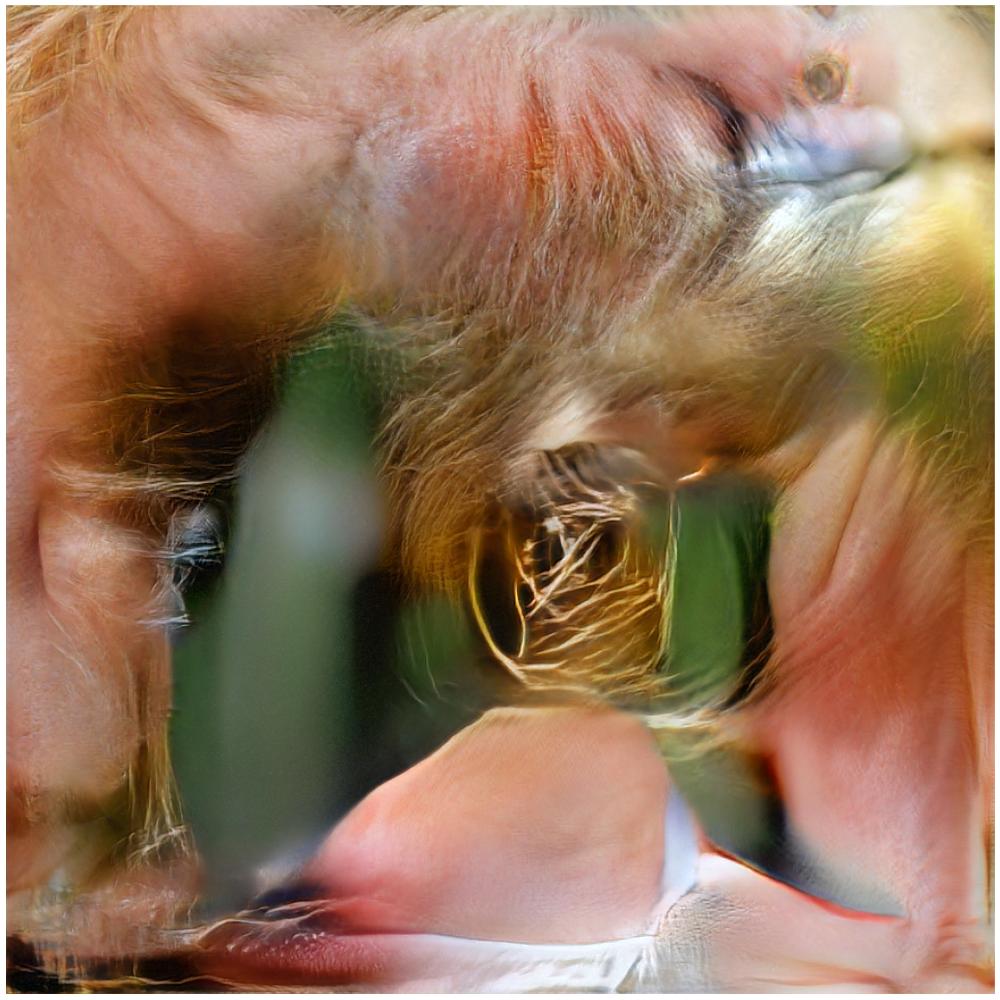

In [235]:
intermediate_latent_vector[:,:5,:]*=-1

out_2 = model.layers[1].predict(intermediate_latent_vector)
out_2 = out_2.transpose([0, 2, 3, 1])
out_2 = np.clip((out_2+1)*0.5, 0, 1)

plt.figure(figsize=(21,21))
plt.axis('off')
plt.imshow(out_2[0])

In [206]:
intermediate_latent_vector[:,:4,:]*=-1

In [204]:
rnd = np.random.RandomState(28526)
latents = rnd.randn(1, 512)

In [190]:
layers_i = [[i,
             layer.name,
             layer.trainable_weights[0].shape.as_list()] 
            for i,layer in enumerate(model.layers[1].layers) 
            if layer.name[-5:]=='Conv1' 
            or layer.name[-8:]=='Conv0_up' 
            or layer.name[-4:]=='Conv' ]
all_weights = [np.copy(model.layers[1].layers[i[0]].get_weights()[0]) for i in layers_i]

In [191]:
layers_i

[[10, 'G_synthesis/4x4/Conv', [3, 3, 512, 512]],
 [17, 'G_synthesis/8x8/Conv0_up', [3, 3, 512, 512]],
 [27, 'G_synthesis/8x8/Conv1', [3, 3, 512, 512]],
 [37, 'G_synthesis/16x16/Conv0_up', [3, 3, 512, 512]],
 [47, 'G_synthesis/16x16/Conv1', [3, 3, 512, 512]],
 [57, 'G_synthesis/32x32/Conv0_up', [3, 3, 512, 512]],
 [67, 'G_synthesis/32x32/Conv1', [3, 3, 512, 512]],
 [77, 'G_synthesis/64x64/Conv0_up', [3, 3, 512, 256]],
 [87, 'G_synthesis/64x64/Conv1', [3, 3, 256, 256]],
 [96, 'G_synthesis/128x128/Conv0_up', [3, 3, 256, 128]],
 [106, 'G_synthesis/128x128/Conv1', [3, 3, 128, 128]],
 [115, 'G_synthesis/256x256/Conv0_up', [3, 3, 128, 64]],
 [125, 'G_synthesis/256x256/Conv1', [3, 3, 64, 64]],
 [134, 'G_synthesis/512x512/Conv0_up', [3, 3, 64, 32]],
 [144, 'G_synthesis/512x512/Conv1', [3, 3, 32, 32]],
 [153, 'G_synthesis/1024x1024/Conv0_up', [3, 3, 32, 16]],
 [163, 'G_synthesis/1024x1024/Conv1', [3, 3, 16, 16]]]

In [179]:
rnd = np.random.RandomState(881139)
latents = rnd.randn(1, 512)

(1, 1024, 1024, 3) 0.0 0.9916625


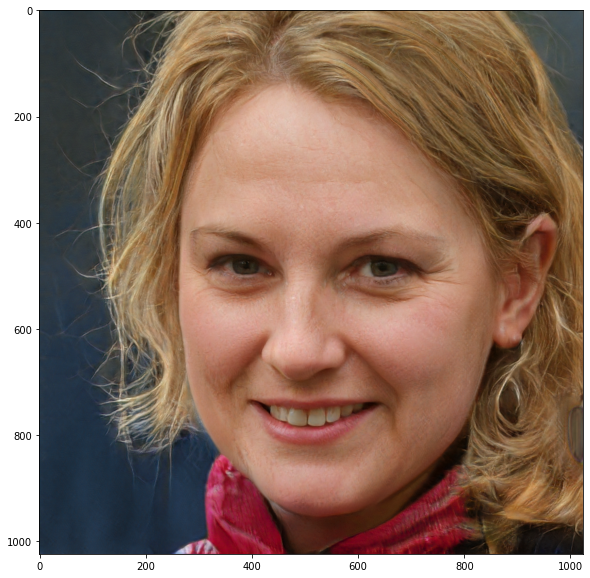

In [180]:
y = model.generate_sample_from_vector(latents,is_visualize=True)

In [ ]:
markd = [28526,9925432,99235432,881139]

(1, 1024, 1024, 3) 0.0 1.0


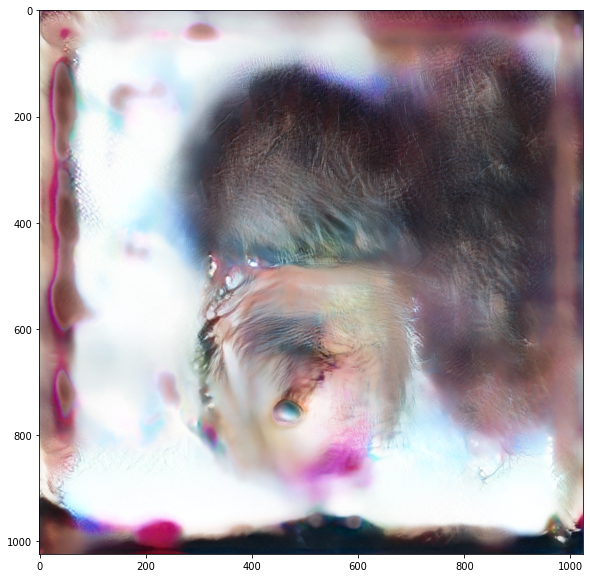

In [114]:
i=4

model.layers[1].layers[layers_i[i][0]].set_weights([np.ones(all_weights[i].shape)/9])
rnd = np.random.RandomState(991432)
latents = rnd.randn(1, 512)

y = model.generate_sample_from_vector(latents,is_visualize=True)

In [ ]:
plt.figure(figsize=(21,21))
plt.axis('off')
plt.imshow(y[0])

## REVERT

In [175]:
model.layers[1].layers[layers_i[i][0]].set_weights([np.copy(all_weights[i])])

(1, 1024, 1024, 3) 0.0 1.0


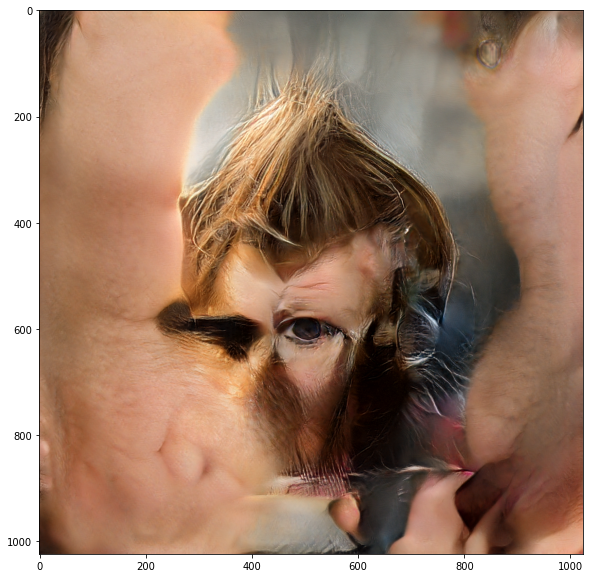

In [197]:
i=2

#model.layers[1].layers[layers_i[i][0]].set_weights([-all_weights[i]])
rnd = np.random.RandomState(8713119)
latents = rnd.randn(1, 512)

y = model.generate_sample_from_vector(latents,is_visualize=True)

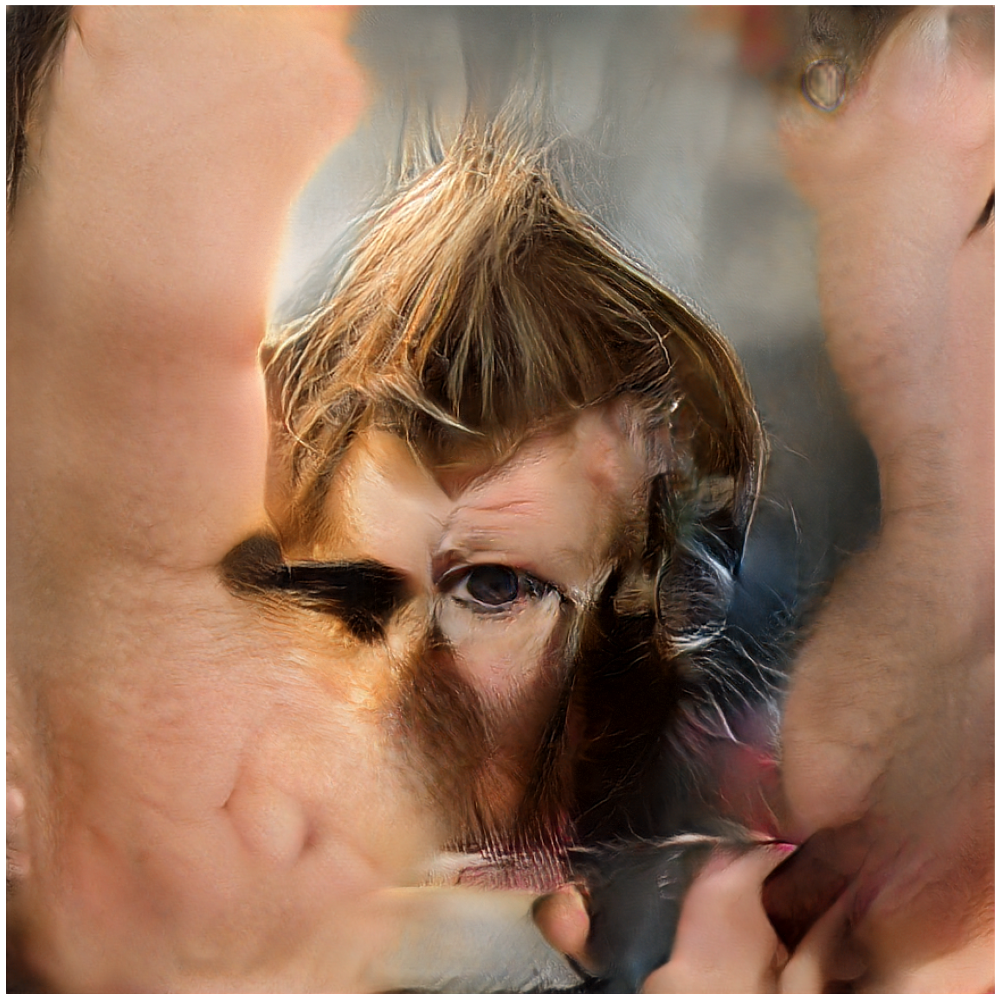

In [198]:
plt.figure(figsize=(21,21))
plt.axis('off')
plt.imshow(y[0])

(1, 1024, 1024, 3) 0.0 1.0


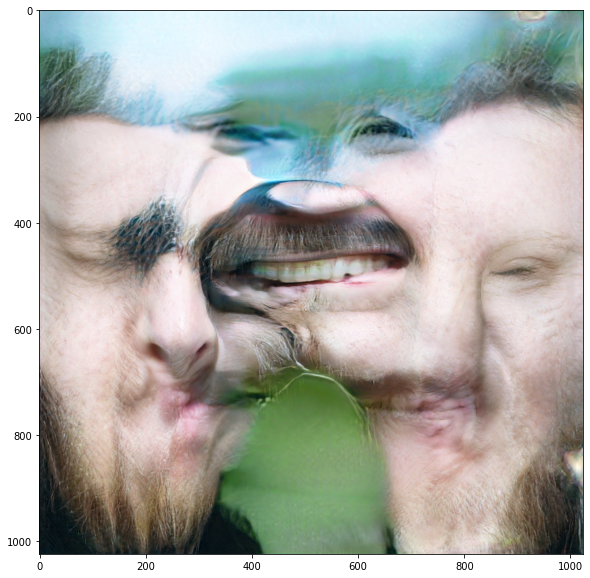

In [188]:
rnd = np.random.RandomState(8881889)
latents = rnd.randn(1, 512)

y = model.generate_sample_from_vector(latents,is_visualize=True)

In [4]:
from numpy import linspace,arccos,clip,dot,sin,asarray
from numpy.linalg import norm

def slerp(val, low, high):
    omega = arccos(clip(dot(low/norm(low), high/norm(high)), -1, 1))
    so = sin(omega)
    if so == 0:
        # L'Hopital's rule/LERP
        return (1.0-val) * low + val * high
    return sin((1.0-val)*omega) / so * low + sin(val*omega) / so * high

# uniform interpolation between two points in latent space
def interpolate_points(p1, p2, n_steps=180):
    # interpolate ratios between the points
    ratios = linspace(0, 1, num=n_steps)
    # linear interpolate vectors
    vectors = list()
    for ratio in ratios:
        v = slerp(ratio, p1, p2)
        vectors.append(v)
    return asarray(vectors)

In [199]:
rnd = np.random.RandomState(28526)
latents_1 = rnd.randn(1, 512)

rnd = np.random.RandomState(8713119)
latents_2 = rnd.randn(1, 512)

interpolates = interpolate_points(latents_2[0],latents_1[0],n_steps=12)

inter_latent = model.layers[0].predict(interpolates)

In [200]:
all_outputs = model.layers[1].predict(inter_latent)

In [201]:
all_outputs = all_outputs.transpose([0, 2, 3, 1])
all_outputs = np.clip((all_outputs+1)*0.5, 0, 1)

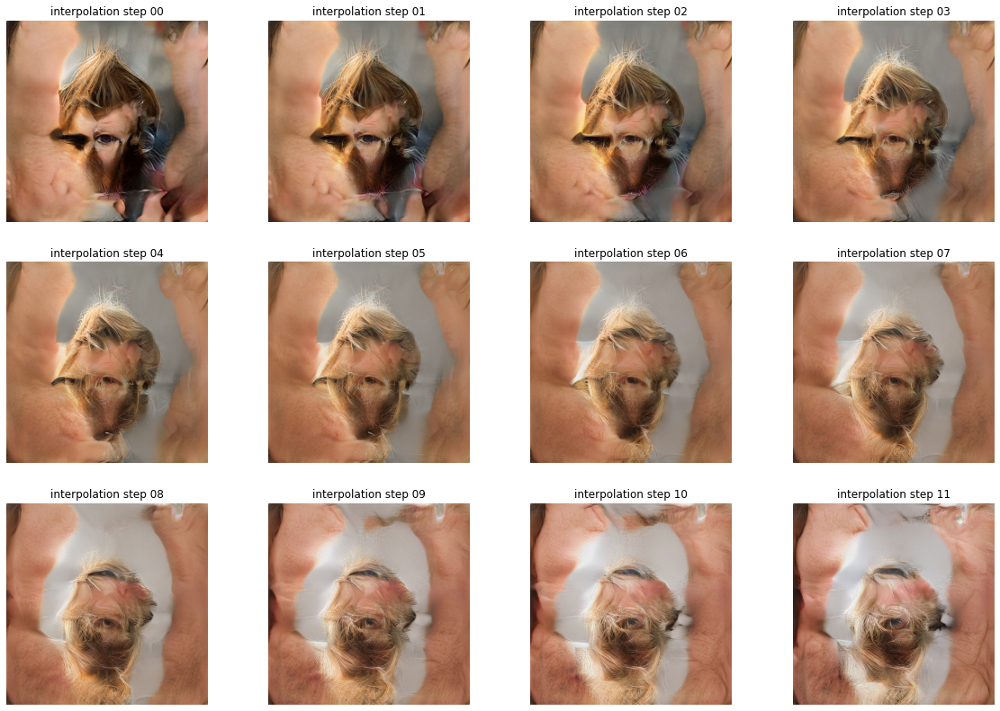

In [202]:
x=4
y=3
fig, axs = plt.subplots(y, x, figsize=(20,14))
for i, output in enumerate(all_outputs):
    axs[int(i/x),i%x].axis('off')
    axs[int(i/x),i%x].title.set_text(f'interpolation step {i:02}')
    axs[int(i/x),i%x].imshow(output)

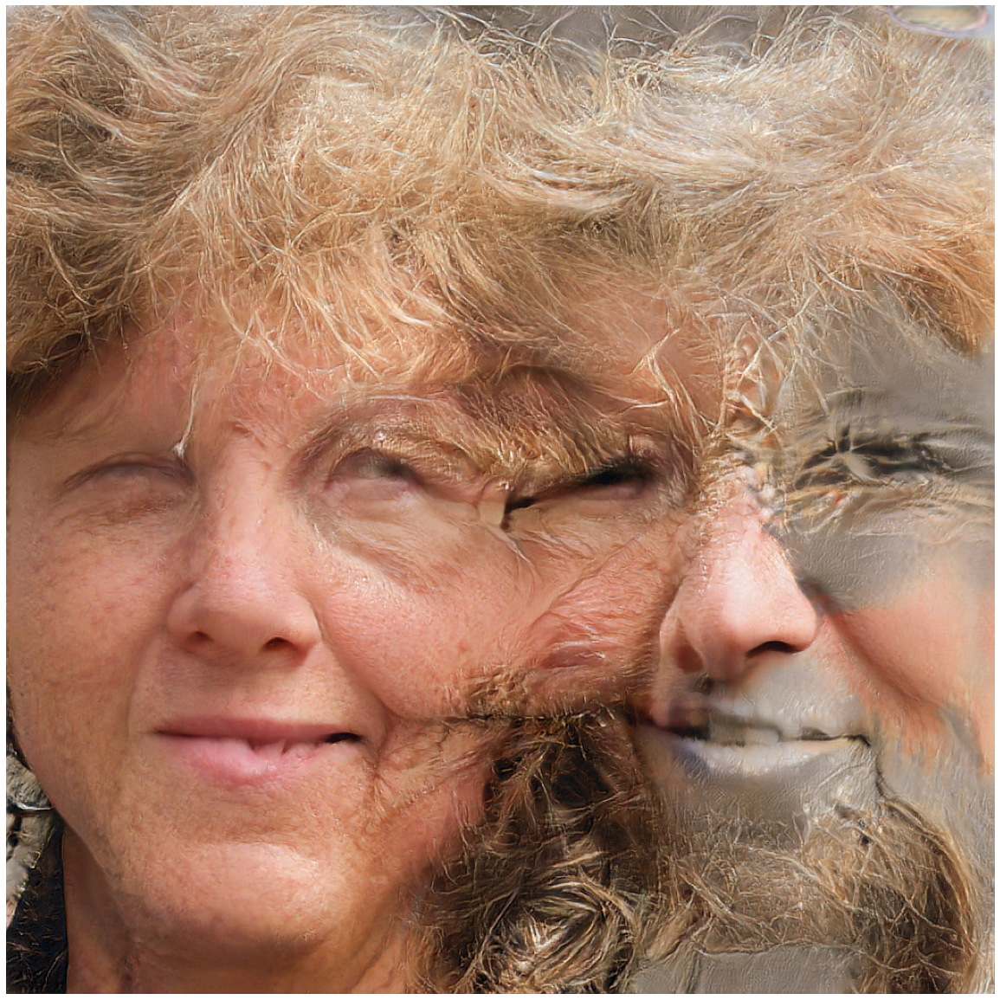

In [174]:
plt.figure(figsize=(21,21))
plt.axis('off')
plt.imshow(all_outputs[8])

In [236]:
model = StyleGAN_G(resolution=1024)

all_weights = pickle.load(open('gs_weights_ffhq.pkl', 'rb'))
print('Weights loaded to memory.')

from stylegan import copy_weights_to_keras_model

copy_weights_to_keras_model(model.model_mapping, all_weights, console=True)
copy_weights_to_keras_model(model.model_synthesis, all_weights, console=True)
model.copy_weights(all_weights)

rnd = np.random.RandomState(28526)
latents = rnd.randn(1, 512)

Model created.
Weights loaded to memory.
.........Total number of parameters copied: 2101760
..........................................................................................Total number of parameters copied: 26381651


In [709]:
operations = [{'resolution':4,
               'install_after':'Conv0_up',
               'layers':[]
               },
              {'resolution':4,
                'install_after':'Conv1',
                'layers':[{'operation':'translate',
                          'name':'21',
                          'translateX':4,
                          'with_norm':True,
                          'clusters':[]}]
               },
              {'resolution':8,
                'install_after':'Conv0_up',
                'layers':[]
               },
              {'resolution':8,
                'install_after':'Conv1',
                'layers':[
                         ]
               },
              {'resolution':16,
                'install_after':'Conv0_up',
                'layers':[
                          {'operation':'erosion',
                           'name':'01',
                           'with_norm':True,
                           'clusters':[1,5,6]},
                          
                         
                          
                          {'operation':'scale',
                           'name':'02',
                           'scale':8,
                           'with_norm':True,
                           'clusters':[1,5,6]},
                          {'operation':'erosion',
                           'name':'03',
                           'with_norm':True,
                           'clusters':[1,5,6]},
                          {'operation':'erosion',
                           'name':'03',
                           'with_norm':True,
                           'clusters':[1,5,6]},
                          {'operation':'erosion',
                           'name':'03',
                           'with_norm':True,
                           'clusters':[4]},
                          
                          
                          {'operation':'scale',
                           'name':'02',
                           'scale':-8,
                           'with_norm':True,
                           'clusters':[0]},
                    {'operation':'translate',
                           'name':'012',
                           'translateY':2,
                           'with_norm':True,
                           'clusters':[]},
                    {'operation':'scale',
                           'name':'102',
                           'scale':-2,
                           'with_norm':True,
                           'clusters':[]},
                          
                          ]
               },
              {'resolution':16,
                'install_after':'Conv1',
                'layers':[]
               },
              {'resolution':32,
                'install_after':'Conv0_up',
                'layers':[]
               },
              {'resolution':32,
                'install_after':'Conv1',
                'layers':[]
               },
              ]

In [710]:
model.rebuild_operations(operations,clusters)

operation: translate[4, 0]
operation applied to 512 layers
operation: erosion
operation applied to 170 layers
operation: scale: 16 -> 24
operation applied to 170 layers
operation: erosion
operation applied to 170 layers
operation: erosion
operation applied to 170 layers
operation: erosion
operation applied to 62 layers
operation: scale: 16 -> 8
operation applied to 45 layers
operation: translate[0, 2]
operation applied to 512 layers
operation: scale: 16 -> 14
operation applied to 512 layers
Synthesis network rebuilt and loaded.


operation: mean_filter
operation applied to 512 layers
operation: scale: 8 -> 8
operation applied to 512 layers
operation: erosion
operation applied to 170 layers
operation: mean_filter
operation applied to 116 layers
operation: mean_filter
operation applied to 195 layers
operation: scale: 16 -> 24
operation applied to 170 layers
operation: erosion
operation applied to 170 layers
operation: erosion
operation applied to 170 layers
operation: erosion
operation applied to 62 layers
operation: scale: 16 -> 8
operation applied to 45 layers
operation: translate[0, 4]
operation applied to 512 layers
(1, 1024, 1024, 3) 0.0 1.0


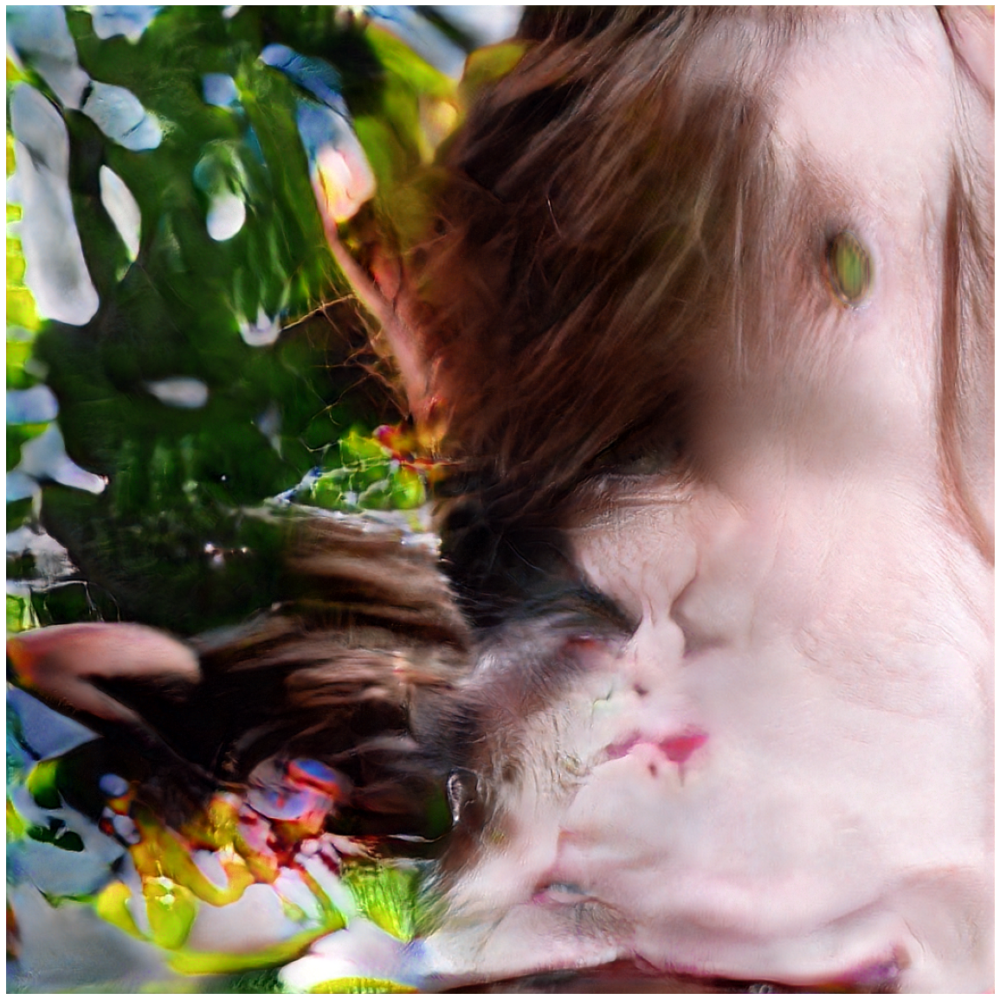

In [682]:
rnd = np.random.RandomState(121514)
latents = rnd.randn(1, 512)

img = model.generate_from_vector_fast(latents,is_visualize=False)

plt.figure(figsize=(21,21))
plt.axis('off')
plt.imshow(img)

clear_session()

In [470]:
marked = [21111,28526]
2761

2761

In [720]:
rnd = np.random.RandomState(23526)
latents_1 = rnd.randn(1, 512)

rnd = np.random.RandomState(73432)
latents_2 = rnd.randn(1, 512)

interpolates = interpolate_points(latents_2[0],latents_1[0],n_steps=12)

inter_latent = model.layers[0].predict(interpolates)

In [721]:
all_outputs = model.layers[1].predict(inter_latent)
all_outputs = all_outputs.transpose([0, 2, 3, 1])
all_outputs = np.clip((all_outputs+1)*0.5, 0, 1)

clear_session()

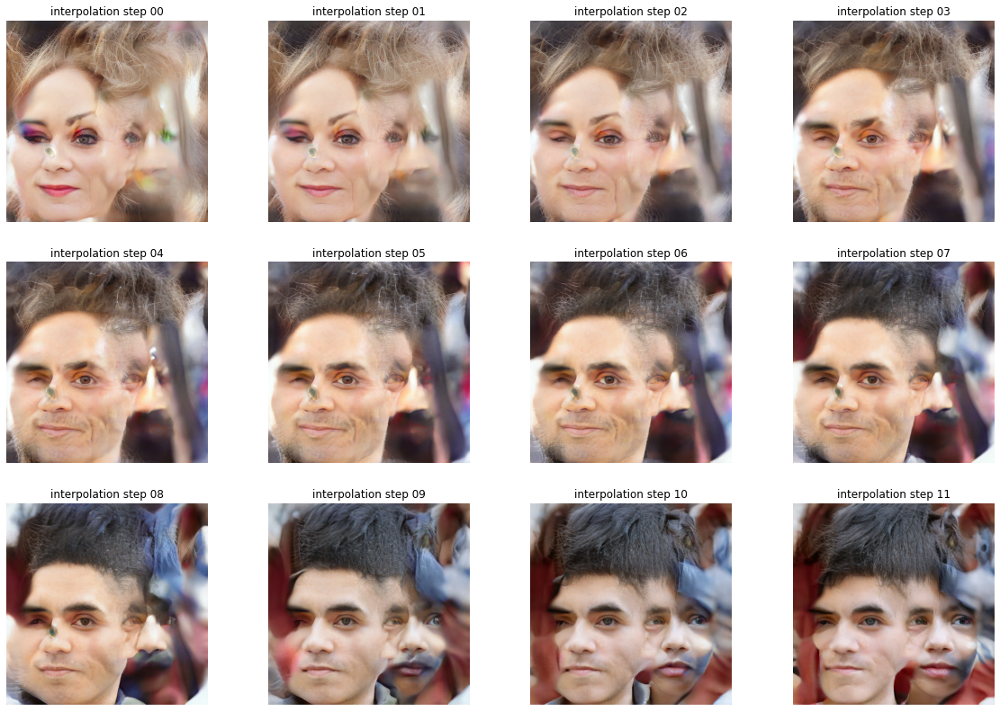

In [722]:
x=4
y=3
fig, axs = plt.subplots(y, x, figsize=(20,14))
for i, output in enumerate(all_outputs):
    axs[int(i/x),i%x].axis('off')
    axs[int(i/x),i%x].title.set_text(f'interpolation step {i:02}')
    axs[int(i/x),i%x].imshow(output)

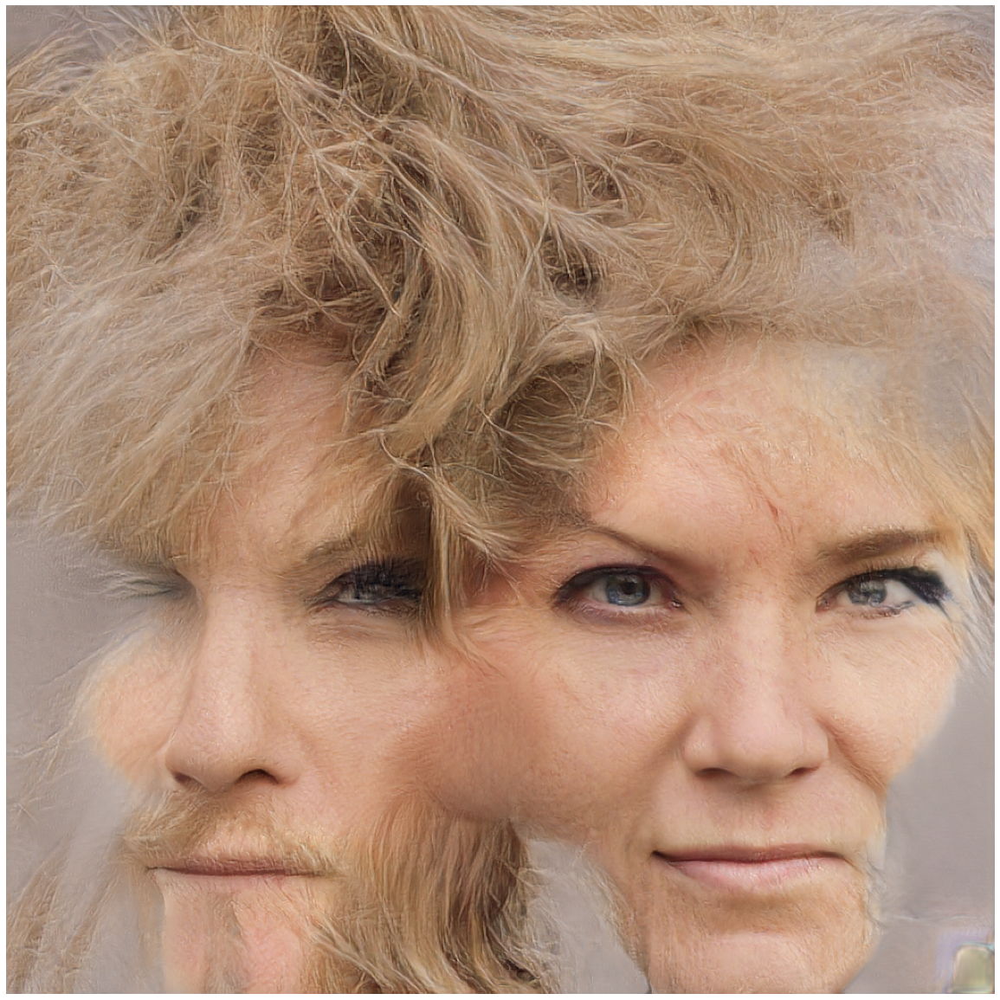

In [708]:
plt.figure(figsize=(21,21))
plt.axis('off')
plt.imshow(all_outputs[7])

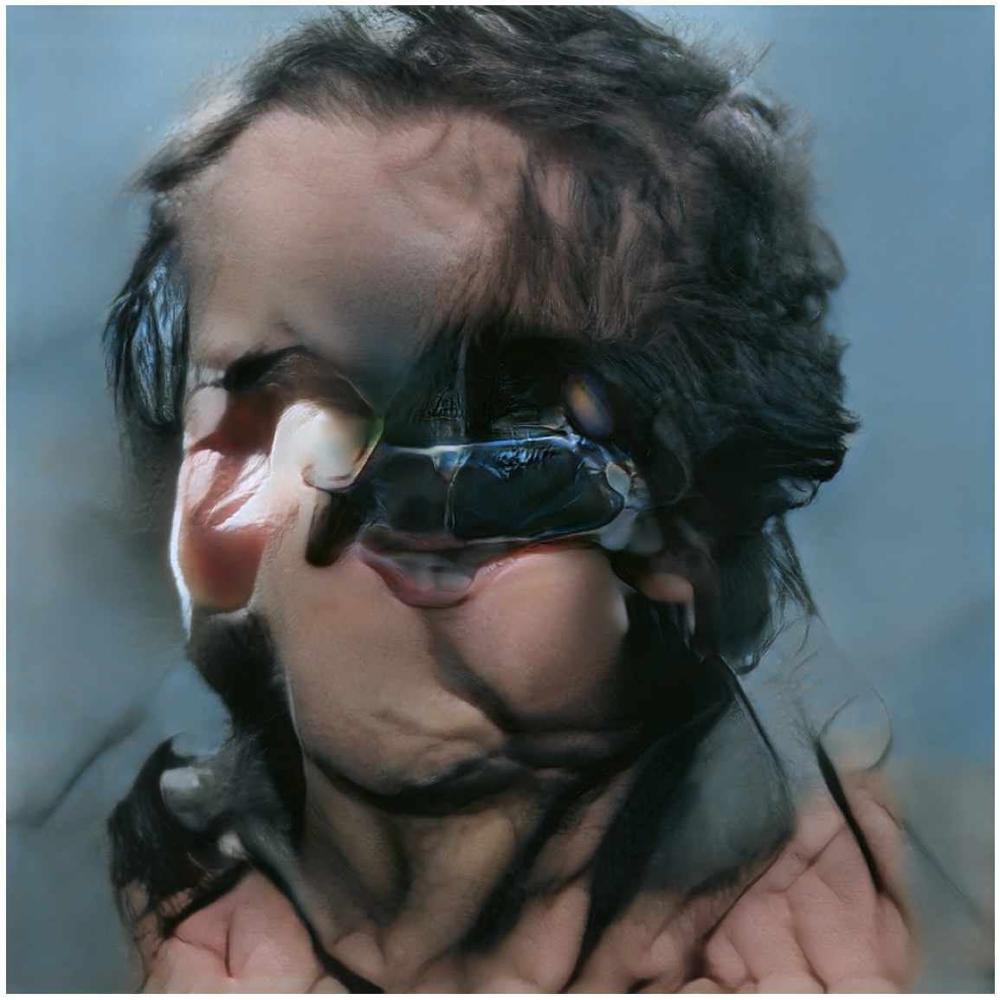

In [402]:
plt.figure(figsize=(21,21))
plt.axis('off')
plt.imshow(all_outputs[11])

In [2]:
import pickle

In [6]:
op2 = pickle.load( open( "./highlights/with_config/002.p", "rb" ) )


In [4]:
op


[{'resolution': 4, 'install_after': 'Conv0_up', 'layers': []},
 {'resolution': 4, 'install_after': 'Conv1', 'layers': []},
 {'resolution': 8, 'install_after': 'Conv0_up', 'layers': []},
 {'resolution': 8, 'install_after': 'Conv1', 'layers': []},
 {'resolution': 16,
  'install_after': 'Conv0_up',
  'layers': [{'operation': 'erosion',
    'name': '01',
    'with_norm': True,
    'clusters': [1, 5, 6],
    'scale': 0,
    'delta': 0,
    'translateX': 0,
    'translateY': 0,
    'filter_shape': 3,
    'rotation': 0,
    'sharpen_factor': 1},
   {'operation': 'mean_filter',
    'name': '02',
    'with_norm': True,
    'filter_shape': 5,
    'clusters': [3],
    'scale': 0,
    'delta': 0,
    'translateX': 0,
    'translateY': 0,
    'rotation': 0,
    'sharpen_factor': 1},
   {'operation': 'mean_filter',
    'name': '02',
    'with_norm': True,
    'filter_shape': 3,
    'clusters': [2],
    'scale': 0,
    'delta': 0,
    'translateX': 0,
    'translateY': 0,
    'rotation': 0,
    'shar

In [7]:
op2

[{'resolution': 4, 'install_after': 'Conv0_up', 'layers': []},
 {'resolution': 4, 'install_after': 'Conv1', 'layers': []},
 {'resolution': 8, 'install_after': 'Conv0_up', 'layers': []},
 {'resolution': 8,
  'install_after': 'Conv1',
  'layers': [{'operation': 'sharpen',
    'name': '01',
    'sharpen_factor': 3,
    'with_norm': True,
    'clusters': [1, 5, 6],
    'scale': 0,
    'delta': 0,
    'translateX': 0,
    'translateY': 0,
    'filter_shape': 3,
    'rotation': 0}]},
 {'resolution': 16,
  'install_after': 'Conv0_up',
  'layers': [{'operation': 'erosion',
    'name': '01',
    'with_norm': True,
    'clusters': [1, 5, 6],
    'scale': 0,
    'delta': 0,
    'translateX': 0,
    'translateY': 0,
    'filter_shape': 3,
    'rotation': 0,
    'sharpen_factor': 1},
   {'operation': 'mean_filter',
    'name': '02',
    'with_norm': True,
    'filter_shape': 5,
    'clusters': [3],
    'scale': 0,
    'delta': 0,
    'translateX': 0,
    'translateY': 0,
    'rotation': 0,
    'sha